In [1]:
import numpy as np
import pandas as pd
from datetime import datetime

In [2]:
data0 = pd.read_csv("/Users/ben/Documents/GitHub/CloudComputing/RedditPlaceData/2023_place_canvas_history-000000000000.csv")
# data1 = pd.read_csv("/Users/ben/Documents/GitHub/CloudComputing/RedditPlaceData/2023_place_canvas_history-000000000001.csv")
# data2 = pd.read_csv("/Users/ben/Documents/GitHub/CloudComputing/RedditPlaceData/2023_place_canvas_history-000000000002.csv")

In [3]:
data0.head()

,timestamp,user,coordinate,pixel_color
0,2023-07-20 13:00:26.088 UTC,no+8HEIDjbdx7/LxH9Xr+h4lyoar0MRTYugWKrGdQOg7dF...,"-199,-235",#FFFFFF
1,2023-07-20 13:00:43.658 UTC,qJ7O6cuUNfkDyn+ZOEYR+UiVEmAu/vYfm/s4hK0XJytqAx...,"0,-298",#FF4500
2,2023-07-20 13:00:43.705 UTC,uqi5XwkBePwcPKJgGOxHKzzzXuZKU6iKZT+OVfUJfaRKek...,"-42,-218",#FFFFFF
3,2023-07-20 13:01:02.487 UTC,rgSTj7FHZUHsLXZLLNj9+vxibHIowb2+UhfFLDYgsVBXqI...,"-418,-232",#B44AC0
4,2023-07-20 13:01:40.445 UTC,2bmivBNj8NYvnp/15k0EqC+75T1OxTtCUcRG2pf0c5btzF...,"182,164",#FF4500


In [5]:
data = data0

In [4]:
data = pd.concat([data0, data1, data2]).reset_index()
data.head()

NameError: name 'data1' is not defined

In [6]:
def parse_coordinate(coordinate):
    if len(coordinate) < 20:
        return coordinate
    else:
        coordinate = coordinate.replace(" ", "").replace(":", ",").split(",")
        x = coordinate[1]
        y = coordinate[3]
        return f"{x}" + "," + f"{y}"
    
data["coordinate"] = data["coordinate"].apply(parse_coordinate)

In [7]:
data["x"] = data["coordinate"].apply(lambda x: int(x.split(",")[0]))

data["y"] = data["coordinate"].apply(lambda x: int(x.split(",")[1]))

In [8]:
def parse_timestamp(timestamp):
    # Check if the timestamp has microsecond part
    if '.' in timestamp:
        return datetime.strptime(timestamp, "%Y-%m-%d %H:%M:%S.%f %Z")
    else:
        return datetime.strptime(timestamp, "%Y-%m-%d %H:%M:%S %Z")

data["timestamp"] = pd.to_datetime(data["timestamp"].apply(parse_timestamp))

In [9]:
data["day"] = data["timestamp"].dt.day

data["hour"] = data["timestamp"].dt.hour

data["minute"] = data["timestamp"].dt.minute

data["second"] = data["timestamp"].dt.second

data["microsecond"] = data["timestamp"].dt.microsecond

In [10]:
data

,timestamp,user,coordinate,pixel_color,x,y,day,hour,minute,second,microsecond
0,2023-07-20 13:00:26.088,no+8HEIDjbdx7/LxH9Xr+h4lyoar0MRTYugWKrGdQOg7dF...,"-199,-235",#FFFFFF,-199,-235,20,13,0,26,88000
1,2023-07-20 13:00:43.658,qJ7O6cuUNfkDyn+ZOEYR+UiVEmAu/vYfm/s4hK0XJytqAx...,"0,-298",#FF4500,0,-298,20,13,0,43,658000
2,2023-07-20 13:00:43.705,uqi5XwkBePwcPKJgGOxHKzzzXuZKU6iKZT+OVfUJfaRKek...,"-42,-218",#FFFFFF,-42,-218,20,13,0,43,705000
3,2023-07-20 13:01:02.487,rgSTj7FHZUHsLXZLLNj9+vxibHIowb2+UhfFLDYgsVBXqI...,"-418,-232",#B44AC0,-418,-232,20,13,1,2,487000
4,2023-07-20 13:01:40.445,2bmivBNj8NYvnp/15k0EqC+75T1OxTtCUcRG2pf0c5btzF...,"182,164",#FF4500,182,164,20,13,1,40,445000
...,...,...,...,...,...,...,...,...,...,...,...
2359613,2023-07-20 15:56:56.139,U/IPcD/Ax3z7ouj584AXbx/w6206pGY/n+VJbbxgGWV1qI...,"449,-51",#3690EA,449,-51,20,15,56,56,139000
2359614,2023-07-20 15:56:56.145,/3twNUBKGhEr13PE2r8EiEHGYsjokOfI9ZjOoEyhYvIWxF...,"99,-304",#FFFFFF,99,-304,20,15,56,56,145000
2359615,2023-07-20 15:56:56.152,rpp4I9n8k7Bx3aGuEpmWHeM4goYYUA6rcia/G9cX5D7QuO...,"253,-433",#B44AC0,253,-433,20,15,56,56,152000
2359616,2023-07-20 15:56:56.152,0wmoh6NGFLNVRraqWJNuKV1vT2dvjT4MNy/JAJvJoy8J0D...,"282,38",#000000,282,38,20,15,56,56,152000


In [11]:
len(data["user"])

7058000

In [12]:
len(pd.unique(data["user"]))

1610835

In [225]:
data["timestamp"][0]

Timestamp('2023-07-20 13:00:26.088000')

In [228]:
data["timestamp"][2359617]

Timestamp('2023-07-20 15:56:56.162000')

In [234]:
# Calculate the amount of time between first and last pixel of this data set
# Expand to do so for each data set
(data["timestamp"][2359617] - data["timestamp"][0]).seconds / (5 * 60)

35.3

In [13]:
data["timestamp"]

0         2023-07-20 13:00:26.088
1         2023-07-20 13:00:43.658
2         2023-07-20 13:00:43.705
3         2023-07-20 13:01:02.487
4         2023-07-20 13:01:40.445
                    ...          
7057995   2023-07-20 19:44:22.581
7057996   2023-07-20 19:44:22.582
7057997   2023-07-20 19:44:22.582
7057998   2023-07-20 19:44:22.582
7057999   2023-07-20 19:44:22.582
Name: timestamp, Length: 7058000, dtype: datetime64[ns]

In [284]:
(data["timestamp"][4779211] - data["timestamp"][2359618]).seconds / (5 * 60)

26.576666666666668

In [14]:
(data["timestamp"][7057998] - data["timestamp"][0]).seconds / (5 * 60)

80.78666666666666

In [301]:
(data["timestamp"][4779211] - data["timestamp"][0]).seconds / (5 * 60)

61.876666666666665

In [285]:
(data["timestamp"][2359617] - data["timestamp"][0]).seconds / (5 * 60)

35.3

In [16]:
pixels_placed = data[["user"]].groupby("user").value_counts().sort_values(ascending=False).reset_index()

In [23]:
pixels_placed[pixels_placed[0] >= 40]

,user,0
0,+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...,987
1,/XIhfEKO27ngFqiOWS5VBLbRGEp8eqMghGEcRtH7xFfwtX...,819
2,ay5U7RmL4QAj/p06ODdMbVh7lc1LqvfZHMFaU6BNIzcIVD...,668
3,UJgZrjNi8XJ9UBsHPJTeU9xqeVB59ccxGwfcyx0gANwQWm...,531
4,WCnhKn9Z11VwjSWd7kOUrX3MWOLhEyaF4FUK0Dxu+DieIW...,288
...,...,...
13677,AcOPo0GB4WCACZ+qCewJyREaqIBTyHGCbzajm/EAF1Upu5...,40
13678,yRkhmfrlebPXGnj7wLCWWr6LxSRq5PdU5wHUlAuVZJUJuh...,40
13679,1lB/LFDw4YO5N/AFvgkHI8CmwmG5nvNL2yQl2X0CFRsuDv...,40
13680,1Qa/Av2XG/KoIrlw0PlItcdGladiEMxj2U2RFMoK5BPjTn...,40


In [344]:
pixels_placed[pixels_placed[0] >= 40].iloc[4]["user"]

'WCnhKn9Z11VwjSWd7kOUrX3MWOLhEyaF4FUK0Dxu+DieIWLcVMlKYqU80Clhu0iMpQecugmUzYonfun3RGtQIw=='

In [28]:
len(pixels_placed[pixels_placed[0] >= 50]["user"])

5642

In [427]:
pixels_placed[pixels_placed[0] >= 50]["user"]

0       +4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...
1       /XIhfEKO27ngFqiOWS5VBLbRGEp8eqMghGEcRtH7xFfwtX...
2       ay5U7RmL4QAj/p06ODdMbVh7lc1LqvfZHMFaU6BNIzcIVD...
3       UJgZrjNi8XJ9UBsHPJTeU9xqeVB59ccxGwfcyx0gANwQWm...
4       WCnhKn9Z11VwjSWd7kOUrX3MWOLhEyaF4FUK0Dxu+DieIW...
                              ...                        
5637    MYn5syPDe+oGM2MsZmV674jxVUUvlf1T7+ZLBueP//3Wr4...
5638    yhJeDysROVJx78fnS1Uz7jyq/0bx1h4xje0HloLMDBu9cs...
5639    D4UFOn/8JDjINX32ajalMMJscX7PF2XCfwwLBSx3dH4jrE...
5640    Lu77+DPoMviQCo9Ana3Q6ygXauyEG/hgOhqZMtDKP2v3ha...
5641    cdSSgVRrZecPcmHq0ppu+SM5X2zAidQReec0AxGr2Uz7sl...
Name: user, Length: 5642, dtype: object

In [32]:
pbs = []

for user in pixels_placed[pixels_placed[0] >= 40]["user"]:
    pbs.append(data[data["user"] == user])


In [33]:
pbs = pd.concat(pbs, ignore_index=False)

pbs

,index,timestamp,user,coordinate,pixel_color,x,y,day,hour,minute,second,microsecond
133238,133238,2023-07-20 13:22:44.303,+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...,"429,443",#FFFFFF,429,443,20,13,22,44,303000
270036,270036,2023-07-20 13:36:06.186,+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...,"166,463",#FFFFFF,166,463,20,13,36,6,186000
350668,350668,2023-07-20 13:43:21.738,+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...,"-498,-500",#000000,-498,-500,20,13,43,21,738000
1117420,1117420,2023-07-20 14:41:01.999,+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...,"198,-308",#FFFFFF,198,-308,20,14,41,1,999000
1124769,1124769,2023-07-20 14:41:31.516,+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+...,"199,-304",#FFD635,199,-304,20,14,41,31,516000
...,...,...,...,...,...,...,...,...,...,...,...,...
5941678,1162466,2023-07-20 19:00:25.439,3udifUQYDP2XC6pkn7e4RMKmgPvGmerBYEQl1m+yeum+AV...,"-207,-346",#000000,-207,-346,20,19,0,25,439000
6125151,1345939,2023-07-20 19:07:41.885,3udifUQYDP2XC6pkn7e4RMKmgPvGmerBYEQl1m+yeum+AV...,"299,194",#000000,299,194,20,19,7,41,885000
6668027,1888815,2023-07-20 19:29:32.321,3udifUQYDP2XC6pkn7e4RMKmgPvGmerBYEQl1m+yeum+AV...,"-232,367",#FFFFFF,-232,367,20,19,29,32,321000
6807794,2028582,2023-07-20 19:34:50.267,3udifUQYDP2XC6pkn7e4RMKmgPvGmerBYEQl1m+yeum+AV...,"-349,398",#FFFFFF,-349,398,20,19,34,50,267000


In [346]:
pb1 = data[data["user"] == '/XIhfEKO27ngFqiOWS5VBLbRGEp8eqMghGEcRtH7xFfwtXRZLw5nwqXSFxU8Ez7u4EM2pc/WCuIQ07Okki1Vew==']
pb2 = data[data["user"] == '+4a1m1b35mqMWxSKCjuo7R37dNk3oXKb52VGz0rJtAaNY+tnQAScZX9RXNjyX6sq+wlIQQthfRPhRVWccf/alQ==']
pb3 = data[data["user"] == 'UJgZrjNi8XJ9UBsHPJTeU9xqeVB59ccxGwfcyx0gANwQWmkLSG9eeYV+UXZWB+tErQ9xQVIQRdrCLstfRrs6tQ==']
pb4 = data[data["user"] == 'ay5U7RmL4QAj/p06ODdMbVh7lc1LqvfZHMFaU6BNIzcIVD1QSn1gerRGhCtGMqewNZKwpcF/LyWn61YF2r3ZDQ==']
pb5 = data[data["user"] == 'WCnhKn9Z11VwjSWd7kOUrX3MWOLhEyaF4FUK0Dxu+DieIWLcVMlKYqU80Clhu0iMpQecugmUzYonfun3RGtQIw==']

pbs = pd.concat([pb1, pb2, pb3, pb4, pb5], ignore_index=False)

In [37]:
tli = pbs.groupby(["x", "y"])["timestamp"].idxmax()

In [39]:
p_pbs = pbs.loc[tli]

In [70]:
# Run this cell
latest_coords = pd.read_parquet("latest_coords99.parquet")
latest_coords.head()

,x,y,idxmax,latest_color
0,-161,259,13,#3690EA
1,3,-300,9,#FFFFFF
2,-500,-481,18,#FFA800
3,81,165,3,#BE0039
4,-25,-138,6,#FFFFFF


In [71]:
# Run this cell
plot = (ggplot(latest_coords, aes(x = "x", y = "y", color = "latest_color")) + 
    geom_point(shape = "s", size = .5) +
    theme(figure_size=[30, 20]) +
    scale_y_reverse() +
    scale_color_identity())

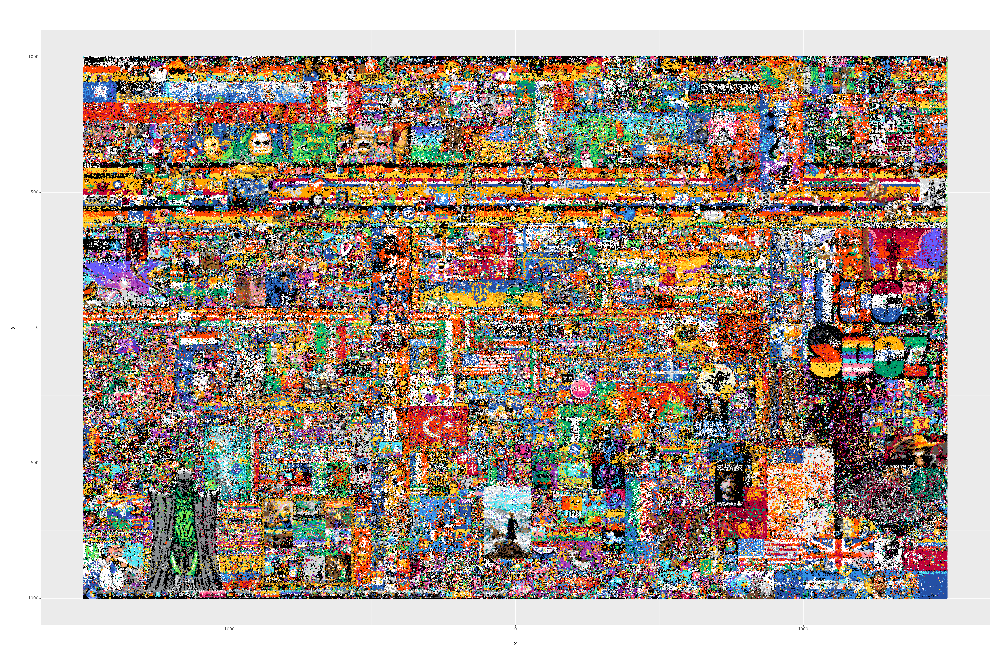

In [72]:
plot.draw()

In [73]:
plot.save(limitsize=False, filename="pbcutoff99.png")

/Users/ben/anaconda3/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 30 x 20 in image.
/Users/ben/anaconda3/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: pbcutoff99.png


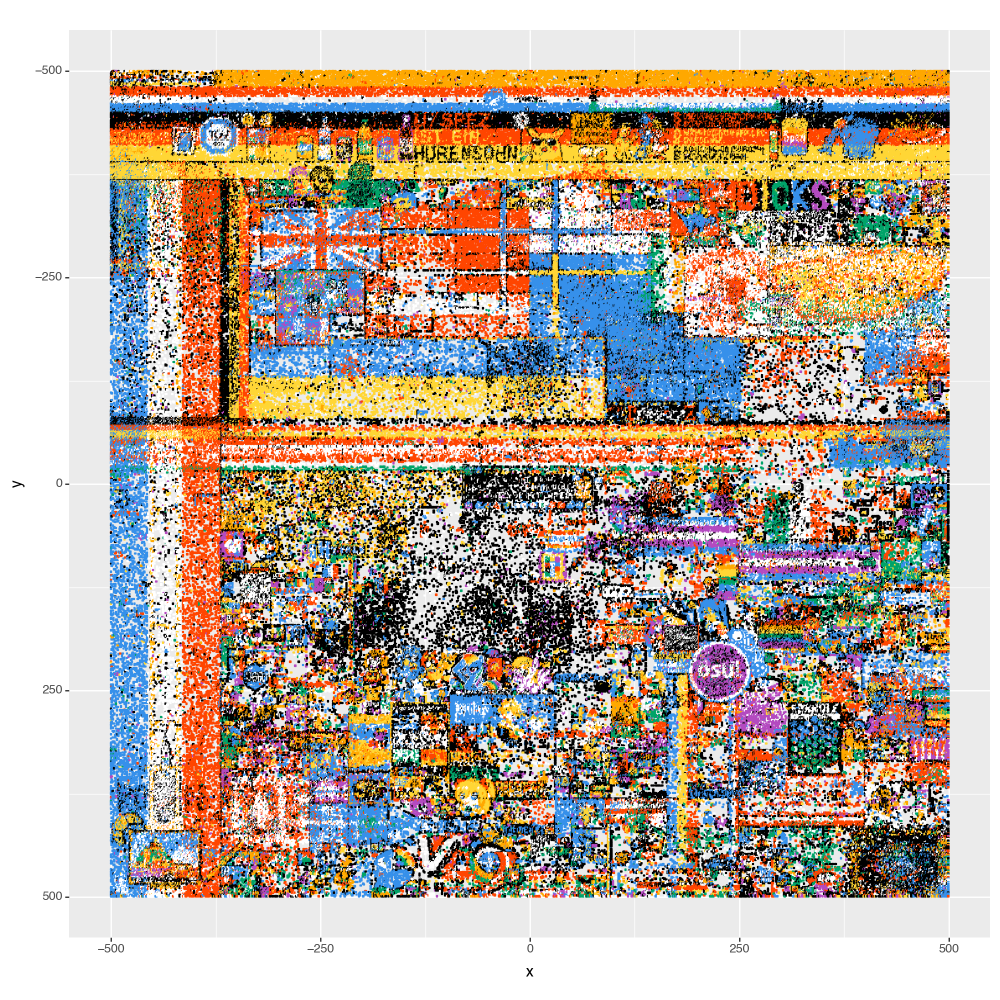

<Figure Size: (1000 x 1000)>

In [40]:
from plotnine import ggplot, aes, geom_point, theme, scale_y_reverse, scale_color_identity
(ggplot(p_pbs, aes(x = "x", y = "y", color = "pixel_color")) + 
    geom_point(shape = "s", size = .01) +
    theme(figure_size=[10, 10]) +
    scale_y_reverse() +
    scale_color_identity())

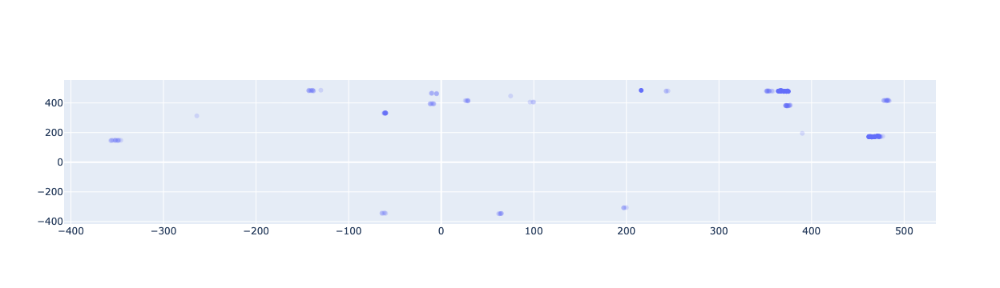

In [223]:
import plotly.graph_objs as go

fig = go.Figure()

trace = go.Scatter(x = pb1["x"], y = pb1["y"], mode = "markers")

fig.add_trace(trace)